# SVM и его ядра
__Суммарное количество баллов: 9__

__Решение отправлять на `ml.course.practice@gmail.com`__

__Тема письма: `[ML][MS][HW07] <ФИ>`, где вместо `<ФИ>` указаны фамилия и имя__

В этом задании нам предстоит решить задачу SVM при помощи `cvxopt` и применить ее к искуственным данным. Затем аналогичным способом нужно будет решить задачу ядерного SVM и исследовать его поведение для различных ядер и значений их параметров.

In [2]:
import copy

import numpy as np
import matplotlib.pyplot as plt

from typing import NoReturn, Callable

from cvxopt import spmatrix, matrix, solvers
from sklearn.datasets import make_classification, make_moons, make_blobs

solvers.options['show_progress'] = False

In [3]:
def visualize(clf, X, y):
    x_min, x_max = X[:, 0].min(), X[:, 0].max()
    y_min, y_max = X[:, 1].min(), X[:, 1].max()
    x_border = (x_max - x_min) / 20 + 1.0e-3
    x_h = (x_max - x_min + 2 * x_border) / 200
    y_border = (y_max - y_min) / 20 + 1.0e-3
    y_h = (y_max - y_min + 2 * y_border) / 200
    
    cm = plt.cm.Spectral

    xx, yy = np.meshgrid(np.arange(x_min - x_border, x_max + x_border, x_h), np.arange(y_min - y_border, y_max + y_border, y_h))
    mesh = np.c_[xx.ravel(), yy.ravel()]

    z_class = clf.predict(mesh).reshape(xx.shape)

    # Put the result into a color plot
    plt.figure(1, figsize=(8, 8))
    plt.pcolormesh(xx, yy, z_class, cmap=cm, alpha=0.3, shading='gouraud')

    # Plot hyperplane and margin
    z_dist = clf.decision_function(mesh).reshape(xx.shape)
    plt.contour(xx, yy, z_dist, [0.0], colors='black')
    plt.contour(xx, yy, z_dist, [-1.0, 1.0], colors='black', linestyles='dashed')

    # Plot also the training points
    y_pred = clf.predict(X)

    ind_support = []
    ind_correct = []
    ind_incorrect = []
    for i in range(len(y)):
        if i in clf.support:
            ind_support.append(i)
        elif y[i] == y_pred[i]:
            ind_correct.append(i)
        else:
            ind_incorrect.append(i)

    plt.scatter(X[ind_correct, 0], X[ind_correct, 1], c=y[ind_correct], cmap=cm, alpha=1., edgecolor='black', linewidth=.8)
    plt.scatter(X[ind_incorrect, 0], X[ind_incorrect, 1], c=y[ind_incorrect], cmap=cm, alpha=1., marker='*',
               s=50, edgecolor='black', linewidth=.8)
    plt.scatter(X[ind_support, 0], X[ind_support, 1], c=y[ind_support], cmap=cm, alpha=1., edgecolor='yellow', linewidths=1.,
               s=40)

    plt.xlim(xx.min(), xx.max())
    plt.ylim(yy.min(), yy.max())
    plt.tight_layout()

In [4]:
def generate_dataset(moons=False, n_samples=1000):
    if moons:
        X, y = make_moons(n_samples=n_samples, noise=0.075, random_state=42)
        return X, 2 * y - 1
    X, y = make_blobs(n_samples=n_samples, n_features=2, centers=[[0, 0], [-4, 2], [3.5, -2.0], [3.5, 3.5]], random_state=42)
    y = 2 * (y % 2) - 1
    return X, y

X, y = generate_dataset(moons=True)

### Задание 1 (2 балла)
Для начала реализуем обычный линейный SVM. 

#### Методы
`fit(X, y)` - обучает SVM, решая задачу оптимизации при помощи `cvxopt.solvers.qp`

`decision_function(X)` - возвращает значение решающей функции (т.е. то число, от которого берем знак с целью узнать класс)

#### Поля
`support` - индексы опорных элементов

### Решение с помощью QP Solver

QP-solver решает такую задачу:

$\begin{cases}0.5 \cdot x^\text{T}Px + q^\text{T}x\rightarrow \min_x\\Gx \leq h\\Ax=b\end{cases}$

А наша задача формулируется так:

$\begin{cases}0.5 \cdot w^\text{T}w + C \cdot \sum \xi_i \rightarrow \min_{w, \xi} \\ \xi \geq 0 \\ y_i (w^\text{T}x_i + w_0) \geq 1 - \xi_i \end{cases}$

Сведем ее к задаче QP-solver'а:

$ x = (w, w_0, \xi) \\ P = 
\left[
    \begin{array}{c|c}
      I & 0\\
      \hline
      0 & 0
    \end{array}
\right] \\ 
q = \left[
    \begin{array}{c}
      0 \\
      \hline
      C 
    \end{array}
\right] \\ 
 G = 
\left[
    \begin{array}{c|c|c}
      0 & 0 & -I\\
      \hline
      -yX & -y & -I
    \end{array}
\right] \\ h = \left[
    \begin{array}{c}
      0 \\
      \hline
      -1 
    \end{array}
\right] $

In [5]:
class LinearSVM:
    def __init__(self, C: float):
        """
        
        Parameters
        ----------
        C : float
            Soft margin coefficient.
        
        """
        self.C = C
        self.support = None

    def fit(self, X: np.ndarray, y: np.ndarray) -> 'LinearSVM':
        """
        Обучает SVM, решая задачу оптимизации при помощи cvxopt.solvers.qp
        
        Parameters
        ----------
        X : np.ndarray
            Данные для обучения SVM.
        y : np.ndarray
            Бинарные метки классов для элементов X 
            (можно считать, что равны -1 или 1). 
        
        """
        N, M = X.shape
                
        P = np.block([
            [np.identity(M), np.zeros((M, N + 1))],
            [np.zeros((N + 1, M)), np.zeros((N + 1, N + 1))]
        ])
        q = np.block([
            [np.zeros((M + 1, 1))],
            [np.ones((N, 1)) * self.C]
        ])
        G = np.block([
            [np.zeros((N, M)), np.zeros((N, 1)), -np.identity(N)],
            [- y * X, -y, -np.identity(N)]
        ])
        h = np.block([
            [np.zeros((N, 1))],
            [-np.ones((N, 1))]
        ])

        P, q, G, h = map(matrix, [P, q, G, h])
        
        x = np.array(solvers.qp(P, q, G, h)["x"])
        
        self.w, self.b, self.eps = x[:M], x[M], x[M + 1:]
        
        margins = (X @ self.w + self.b) * y
        self.support = np.where(margins <= 1)[0]

        return self

    def decision_function(self, X: np.ndarray) -> np.ndarray:
        """
        Возвращает значение решающей функции.
        
        Parameters
        ----------
        X : np.ndarray
            Данные, для которых нужно посчитать значение решающей функции.

        Return
        ------
        np.ndarray
            Значение решающей функции для каждого элемента X 
            (т.е. то число, от которого берем знак с целью узнать класс).     
        
        """
        pred = X @ self.w + self.b
        
        return pred

    def predict(self, X: np.ndarray) -> np.ndarray:
        """
        Классифицирует элементы X.
        
        Parameters
        ----------
        X : np.ndarray
            Данные, которые нужно классифицировать

        Return
        ------
        np.ndarray
            Метка класса для каждого элемента X.   
        
        """
        return np.sign(self.decision_function(X))

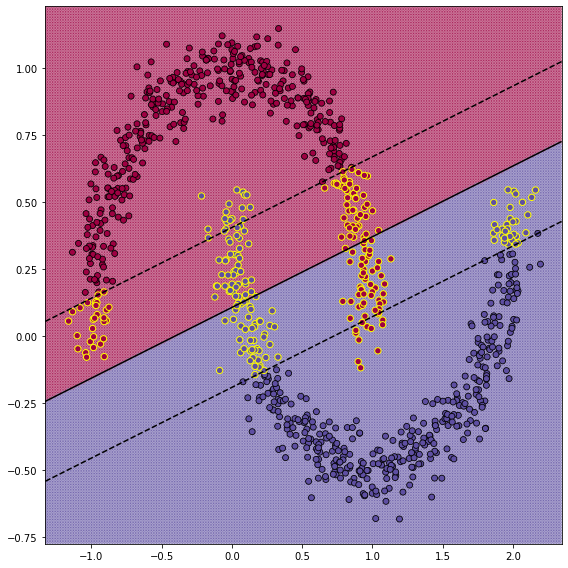

In [6]:
X, y = generate_dataset(moons=True)
svm = LinearSVM(1)
svm.fit(X, y.reshape(-1, 1))
visualize(svm, X, y)
plt.show()

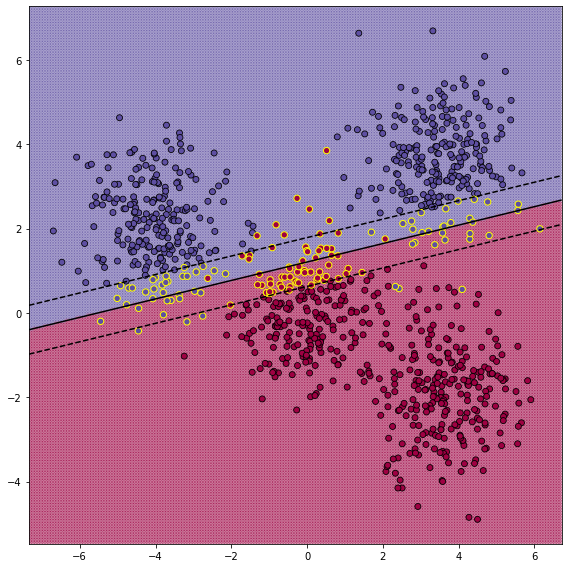

In [7]:
X, y = generate_dataset(moons=False)
svm = LinearSVM(1)
svm.fit(X, y.reshape(-1, 1))
visualize(svm, X, y)
plt.show()

### Задание 2 (2 балла)
Перед реализацией ядерного SVM, реализуем функции, которые строят ядра.

#### Описание
`get_polynomial_kernel(power)` - возвращает полиномиальное ядро с заданной константой и степенью

`get_gaussian_kernel(sigma=1.)` - возвращает ядро Гаусса с заданным коэффицинтом сигма

In [8]:
def get_linear_kernel():
    "Возвращает линейное ядро"
    return lambda x, y: x @ y

def get_polynomial_kernel(c=1, power=2):
    "Возвращает полиномиальное ядро с заданной константой и степенью"
    return lambda x, y: (c + x @ y)**power

def get_gaussian_kernel(sigma=1.):
    "Возвращает ядро Гаусса с заданным коэффицинтом сигма"
    pairwise_norm = lambda x, y: np.sum((x[:, None] - y)**2, axis=-1)
    
    gamma = 1 / 2*sigma**2

    return lambda x, y: np.exp(-gamma * pairwise_norm(x, y))

### Задание 3 (2 балла)
Теперь перейдем к реализации самого kernel SVM.

#### Описание
`fit(X, y)` - обучает kernel SVM, решая задачу оптимизации при помощи `cvxopt.solvers.qp`

`decision_function(X)` - возвращает значение решающей функции (т.е. то число, от которого берем знак с целью узнать класс)

#### Конструктор
`kernel` - ядро-функция

### Решение с помощью QP Solver

QP-solver решает такую задачу:

$\begin{cases}0.5 \cdot x^\text{T}Px + q^\text{T}x\rightarrow \min_x\\Gx \leq h\\Ax=b\end{cases}$

Будем решать двойственную задачу. Формулируется она так:

$\begin{cases}\sum \alpha_i - 0.5 \sum \alpha_i \alpha_j y_i y_j K(x_i, x_j) \rightarrow \max_{\alpha}\\ C \geq \alpha \geq 0 \\ y_i \alpha = 0 \end{cases}$

Сведем ее к задаче QP-solver'а:

$ x = \alpha \\ P = 
\left[ y_i y_j K(x_i, x_j) \right] \\ 
q = \left[ -1
\right] \\ 
 G = 
\left[
    \begin{array}{c}
      I\\
      \hline
      -I
    \end{array}
\right] \\ h = \left[
    \begin{array}{c}
      C \\
      \hline
      0 
    \end{array}
\right] \\
b = 0\\
A = y^\text{T}$

В таком случае решающей функцией будет:

$a(x) = \text{sign} (\sum \alpha_i y_i K(x, x_i) + w_0)$, где $w_0 = \frac{1}{n}\sum\limits_{i=1}^{n}[y_i - \sum \alpha_j y_j K(x_i, x_j)]$

In [9]:
class KernelSVM:
    def __init__(self, C: float, kernel: str = "linear", c: float=1, power: float=2, sigma: float=1.0):
        """
        
        Parameters
        ----------
        C : float
            Soft margin coefficient.
        kernel : Callable
            Функция ядра.
        
        """
        self.C = C
        self.kernel_name = kernel
        self.K = self._get_kernel(kernel, c, power, sigma)
        
        self.support = None
        
    def _get_kernel(self, name, c, power, sigma):
        if name == "linear":
            return get_linear_kernel()
        elif name == "poly":
            return get_polynomial_kernel(c=c, power=power)
        elif name == "radial":
            return get_gaussian_kernel(sigma=sigma)
        else:
            raise AttributeError("Unknown kernel")
        
    def _check_kernel_input(self, X, Y):
        if self.kernel_name == "linear" or self.kernel_name == "poly":
            return X, Y.T
        elif self.kernel_name == "radial":
            return X, Y
        else:
            raise AttributeError("Unknown kernel")
            
    def fit(self, X: np.ndarray, y: np.ndarray) -> 'KernelSVM':
        """
        Обучает SVM, решая задачу оптимизации при помощи cvxopt.solvers.qp
        
        Parameters
        ----------
        X : np.ndarray
            Данные для обучения SVM.
        y : np.ndarray
            Бинарные метки классов для элементов X 
            (можно считать, что равны -1 или 1). 
        
        """
        N, M = X.shape
        
        P = np.outer(y, y) * self.K(*self._check_kernel_input(X, X))
        q = -np.ones((N, 1))
        G = np.block([
            [np.identity(N)],
            [-np.identity(N)]
        ])
        h = np.block([
            [np.ones((N, 1)) * self.C],
            [np.zeros((N, 1))]
        ])
        b = np.zeros((1, 1))
        A = y.reshape(1, -1).astype(np.float)
        
        P, q, G, h, b, A = map(matrix, [P, q, G, h, b, A])
        
        self.a = np.array(solvers.qp(P, q, G, h, A, b)["x"]).reshape(1, -1)
        
        self.X, self.y = X, y.reshape(1, -1)

        margins = self.decision_function(X) * y
        self.support = np.where(margins <= 1)[0] # to slow?
        
        return self

    def _get_bias(self, X, y):
        ker = np.sum(self.a * self.y * self.K(*self._check_kernel_input(X, X)), axis=1)
        
        return (1 / X.shape[0]) * np.sum(y - ker)
    
    def decision_function(self, X: np.ndarray) -> np.ndarray:
        """
        Возвращает значение решающей функции.
        
        Parameters
        ----------
        X : np.ndarray
            Данные, для которых нужно посчитать значение решающей функции.

        Return
        ------
        np.ndarray
            Значение решающей функции для каждого элемента X 
            (т.е. то число, от которого берем знак с целью узнать класс).     
        
        """
        b = self._get_bias(self.X, self.y)

        decision = np.sum(self.a * self.y * self.K(*self._check_kernel_input(X, self.X)), axis=1) + b
        
        return decision

    def predict(self, X: np.ndarray) -> np.ndarray:
        """
        Классифицирует элементы X.
        
        Parameters
        ----------
        X : np.ndarray
            Данные, которые нужно классифицировать

        Return
        ------
        np.ndarray
            Метка класса для каждого элемента X.   
        
        """

        return np.sign(self.decision_function(X))

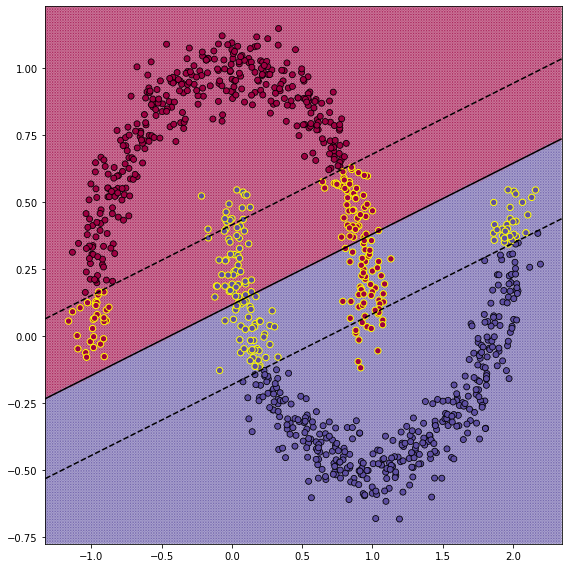

In [10]:
X, y = generate_dataset(moons=True)
svm = KernelSVM(1, kernel="linear")
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

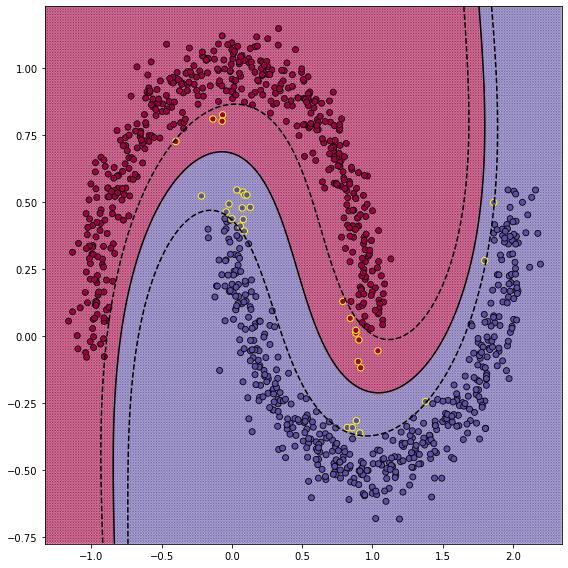

In [11]:
X, y = generate_dataset(moons=True)
svm = KernelSVM(1, kernel="poly", c=1, power=3)
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

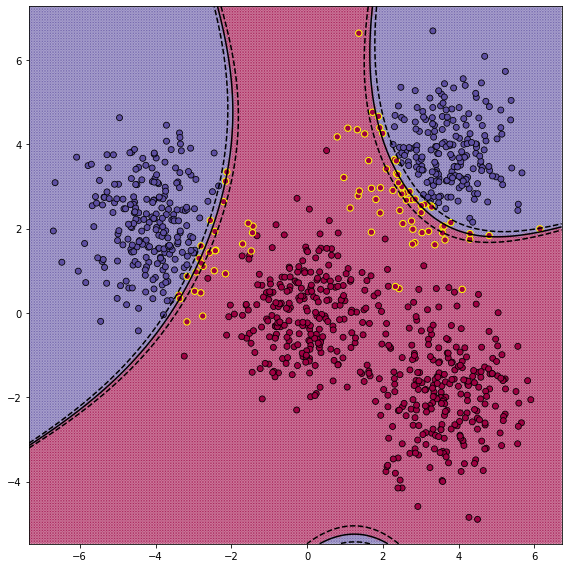

In [12]:
X, y = generate_dataset(moons=False)
svm = KernelSVM(1, kernel="poly", c=1, power=3)
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

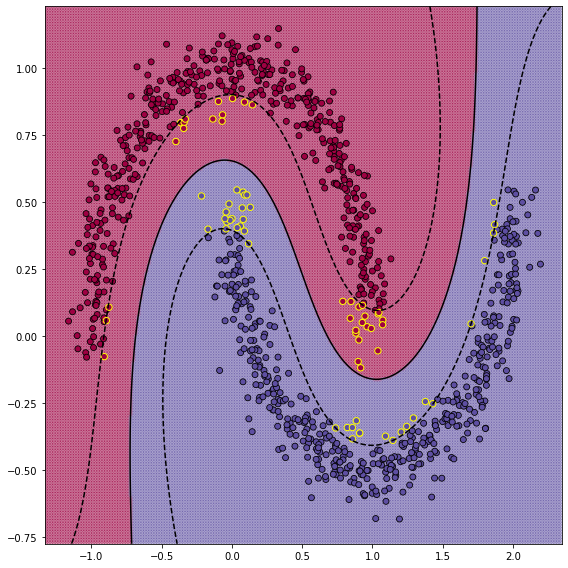

In [13]:
X, y = generate_dataset(moons=True)
svm = KernelSVM(1, kernel="radial", sigma=1.2)
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

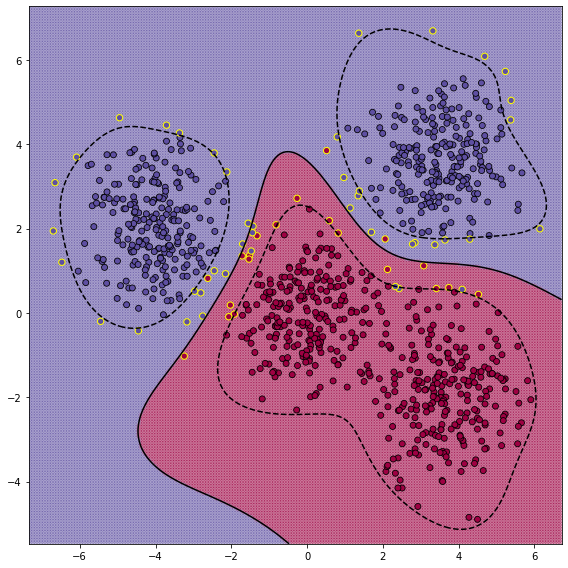

In [14]:
X, y = generate_dataset(moons=False)
svm = KernelSVM(1.0, kernel="radial", sigma=0.7)
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

### Задание 4 (3 балла)
Исследуйте и опишите влияние параметров каждого вида ядра на полученный классификатор. Что происходит при увеличении константы в полиномиальном ядре? При увеличении степени? Как влияет на результат сигма в ядре Гаусса?

__При выполнении этого задания стоит написать код, который визуализирует классификаторы с различными ядрами__

In [15]:
X_moon, y_moon = generate_dataset(moons=True, n_samples=300)
X_blobs, y_blobs = generate_dataset(moons=False, n_samples=300)

### Влияние $С$

Параметр С отвечает за силу штрафа - то, насколько сильно мы можем в сумме ошибаться на каждой точке ($\xi$). Закономерно, при его увеличении мы усиливаем штраф и разделяющая граница становится уже. При чрезмерном штрафе мы начинаем относить точки уже к неправильному классу.

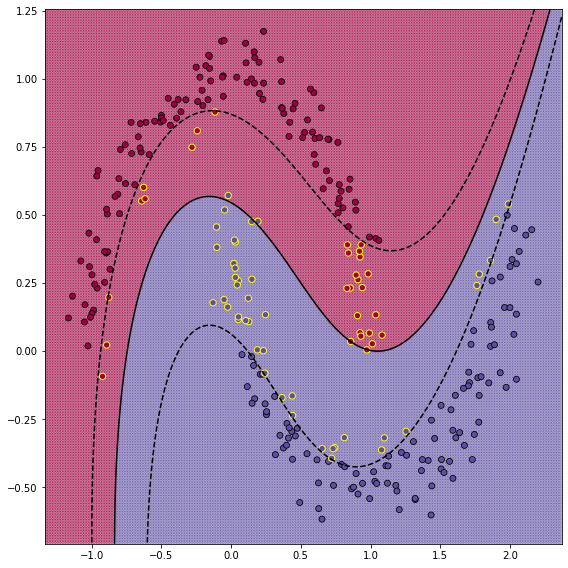

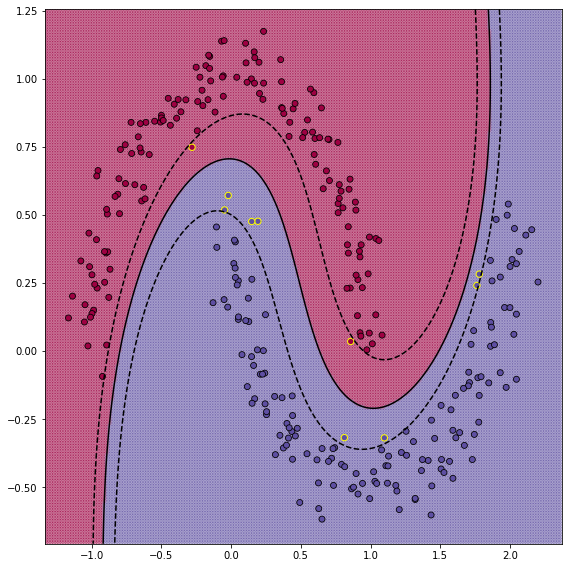

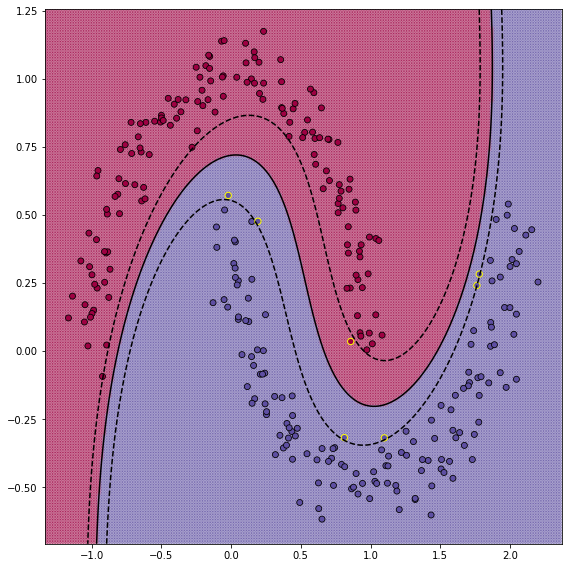

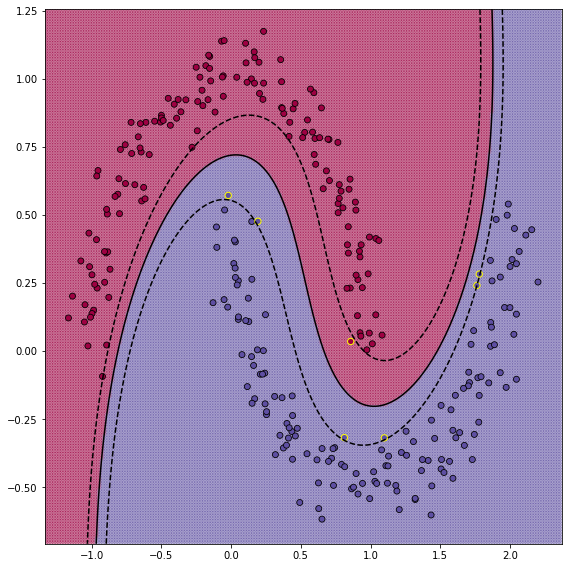

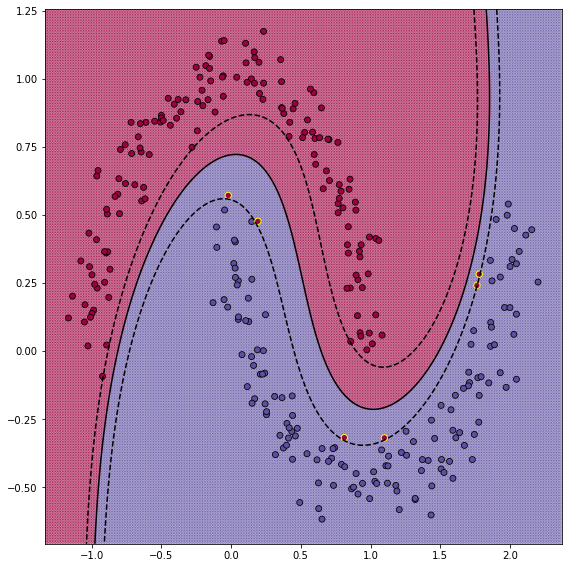

In [16]:
for i, C in enumerate(np.linspace(0.1, 15, num=5)):
    svm = KernelSVM(C, kernel="poly", c=1, power=3)
    svm.fit(X_moon, y_moon)
    visualize(svm, X_moon, y_moon)
    plt.show()

### Влияние $c$ и $d$

В полиномиальном ядре $c$ отвечает за смещение (когда скалярное произведение равно 0), либо как компенсация если признакие не центрированы.
Насколько видно из графика, чем меньше $c$, тем сильнее оказывается смещение, особенно около 0. При больших значениях $c$ смещение около 0 выравнивается и дальше почти не меняется. 

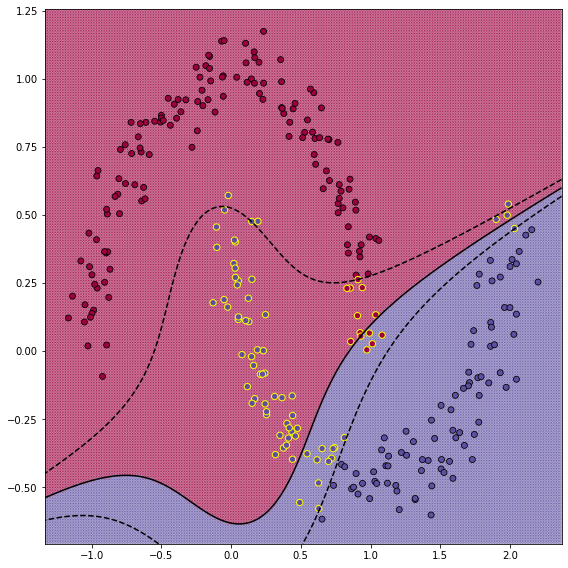

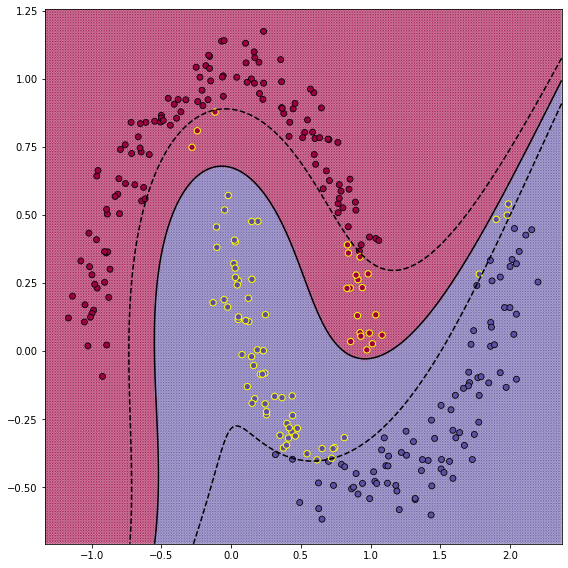

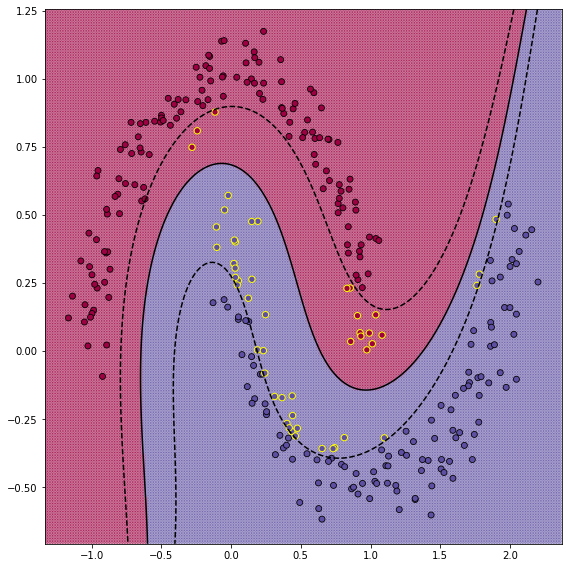

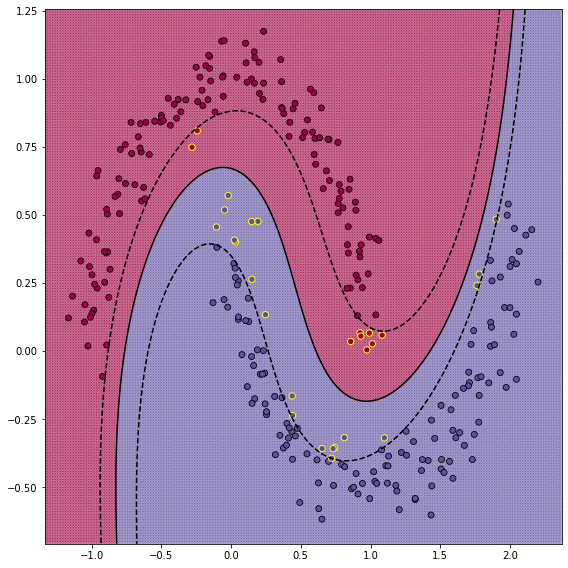

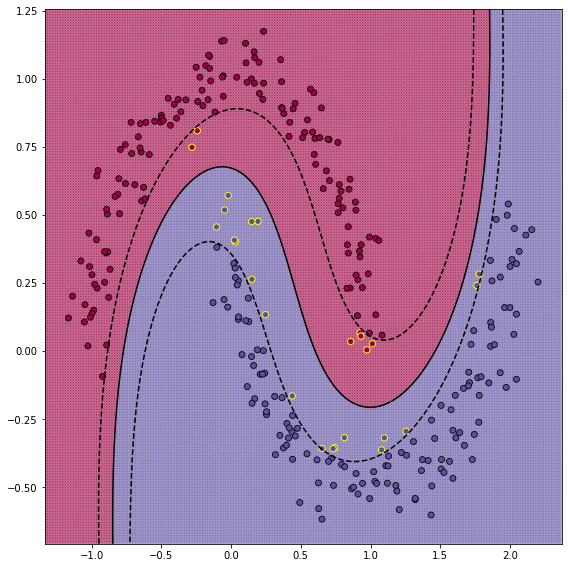

In [17]:
for i, c in enumerate([0.01, 0.1, 0.3, 0.6, 0.8]):
    svm = KernelSVM(1, kernel="poly", c=c, power=3)
    svm.fit(X_moon, y_moon)
    visualize(svm, X_moon, y_moon)
    plt.show()

При увеличении степени в полиномиальном ядре мы попадает в пространства более высокой размерности, а наша модель получает больше возможностей для аппроксимации. Однако, при слишком маленькой степени модель получается недообученной, а при слишком большой - переобученной.

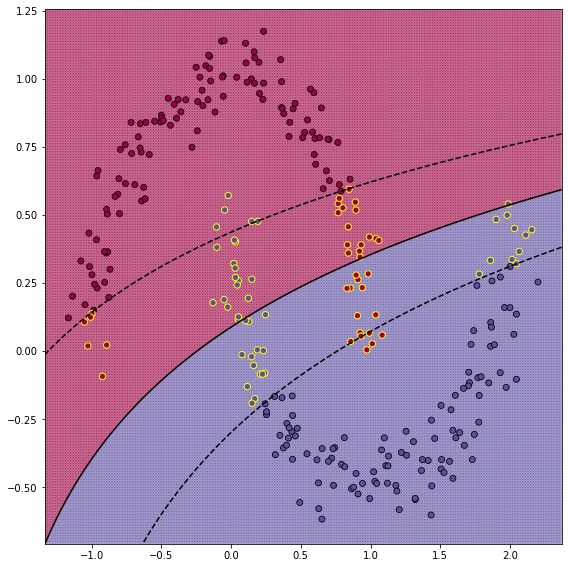

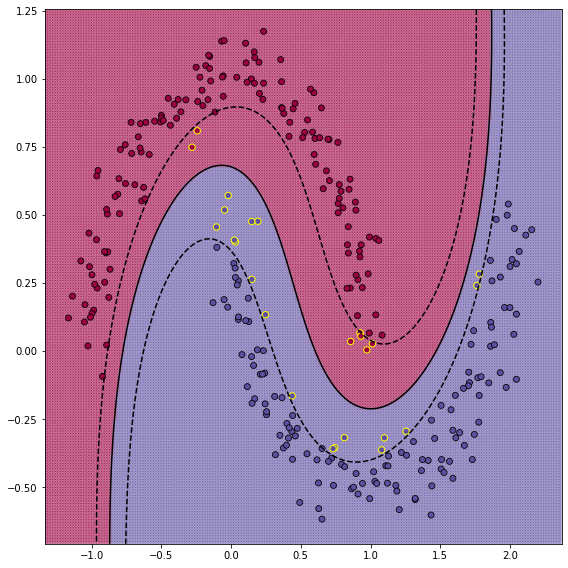

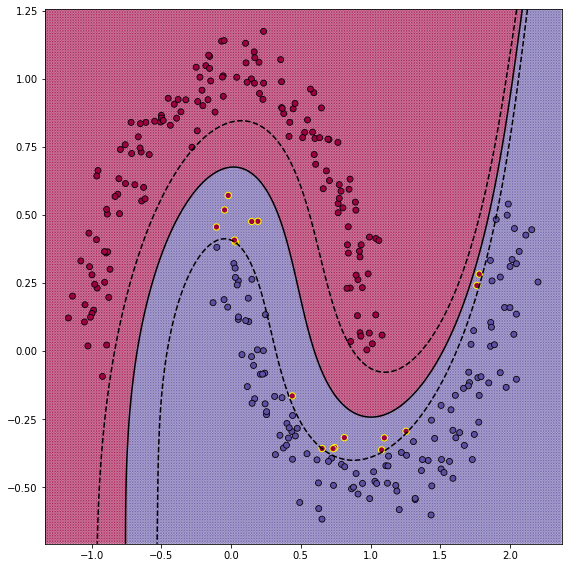

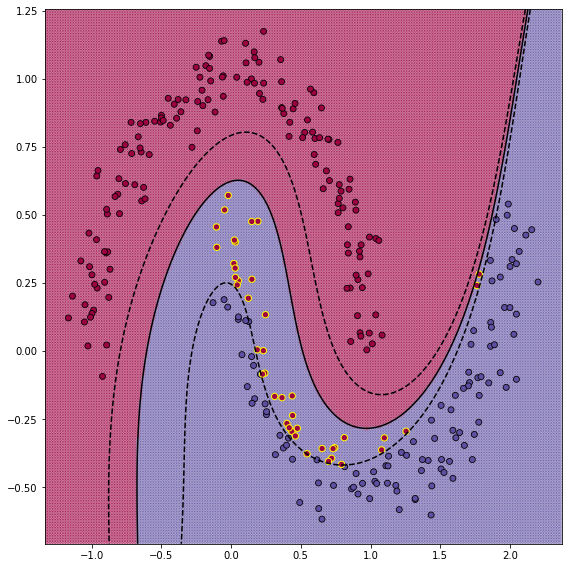

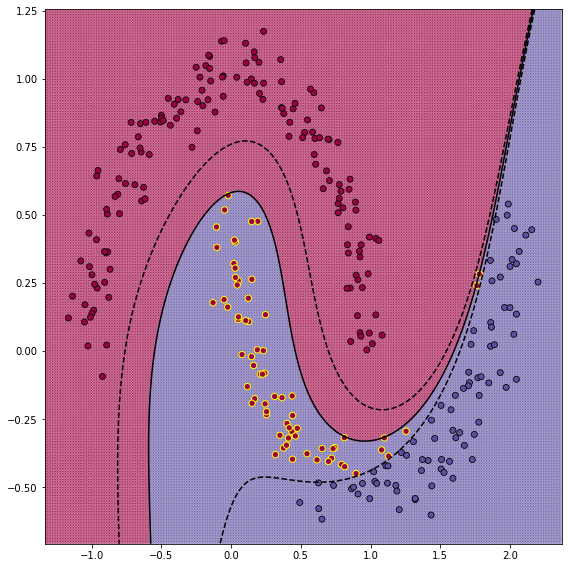

In [230]:
for i, d in enumerate([2, 3, 4, 8, 12]):
    svm = KernelSVM(1, kernel="poly", c=1.0, power=d)
    svm.fit(X_moon, y_moon)
    visualize(svm, X_moon, y_moon)
    plt.show()

### Влияние $\sigma$

Насколько я понял, $\sigma$ отвечает за ширину колокола из нормального распредления. Т.к. разделяющая плоскость образуется из таких колоколов, то $\sigma$ [напрямую влияет на их охват](https://www.quora.com/What-is-the-intuition-behind-Gaussian-kernel-in-SVM-How-can-I-visualize-the-transformation-function-%CF%95-that-corresponds-to-the-Gaussian-kernel-Why-is-the-Gaussian-kernel-popular). Если в терминах $\gamma$, то значение ядра при маленькой $\gamma$ будет маленьким даже для близких друг другу векторов, что дает более сложную разделяющую плоскость. И наоборот.

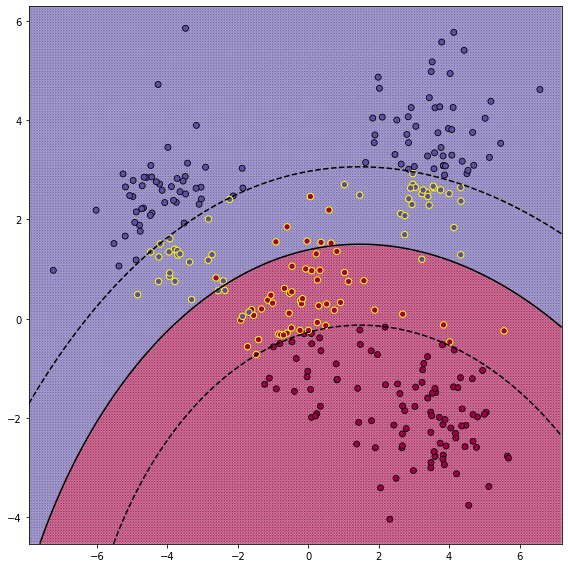

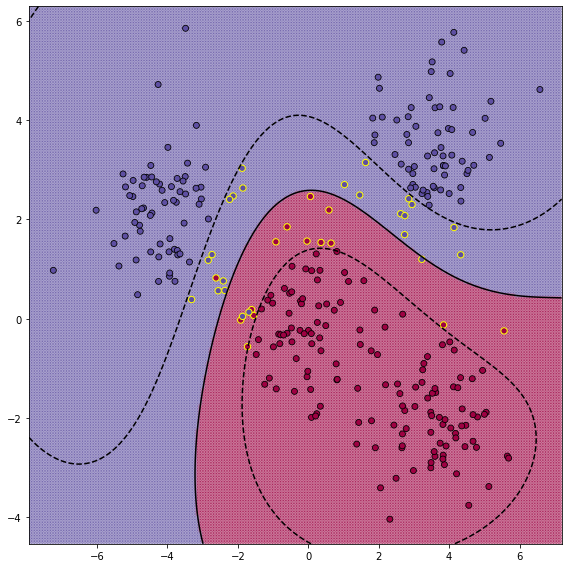

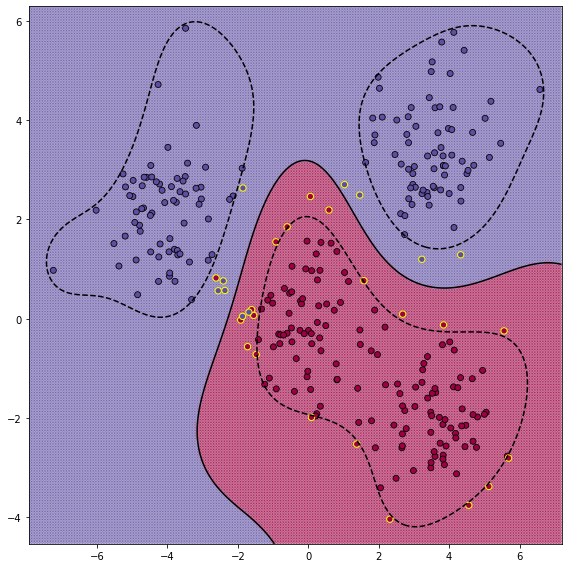

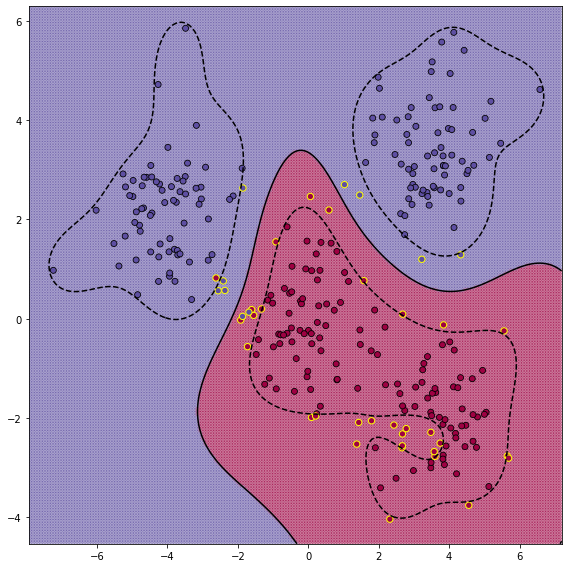

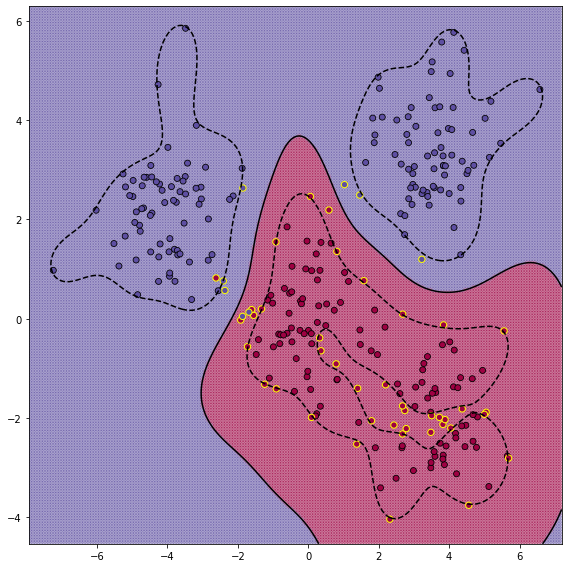

In [232]:
for i, sigma in enumerate([0.1, 0.3, 0.6, 0.8, 1.0]):
    svm = KernelSVM(1, kernel="radial", sigma=sigma)
    svm.fit(X_blobs, y_blobs)
    visualize(svm, X_blobs, y_blobs)
    plt.show()